# Emily Tseng (et397)

## 0) Mini-project

For my mini-project I'll be doing an analysis of a dataset of transcripts from talk therapy on an online platform. One of my research partners has provided access to ~11k patients' transcripts (all patients gave informed consent for the use of their treatment data in research), along with labels for therapeutic alliance (the degree to which patients feel their therapists are allied with them in therapy). I'll be submitting an annotated ipynb exploring the dataset using some of the methods we've discussed in this course, including visualization of the text and outcome data.

## 1) 

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import tree
%matplotlib inline

import random
from tqdm import tqdm

In [2]:
X_train = np.array([[0.165, 0.013], [0.113, 0.133], [-0.098, 0.17], [-0.317, 0.133],
    [-0.369, -0.033], [-0.317, -0.281], [-0.071, -0.428], [0.27, -0.373], [0.454, -0.152],
    [0.524, 0.317], [0.358, 0.427], [-0.045, 0.565], [-0.352, 0.62], [-0.606, 0.492],
    [-0.869, -0.097], [-0.781, 0.243], [-0.772, -0.401], [-0.65, -0.64], [-0.352, -0.686],
    [-0.106, -0.796], [0.244, -0.759], [0.656, -0.631], [-0.159, -0.033], [-0.071, -0.217],
    [0.165, -0.171], [0.051, -0.208], [0.288, -0.088], [0.349, 0.133], [0.104, 0.372],
    [-0.133, 0.409], [-0.343, 0.335], [-0.457, 0.289], [-0.562, 0.17], [-0.588, -0.005],
    [-0.606, -0.235], [-0.606, -0.428], [-0.466, -0.493], [-0.308, -0.511], [-0.124, -0.603],
    [0.2, -0.566], [0.402, -0.539], [0.638, -0.327], [-0.667, -0.097]])
y_train=np.array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
                  1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [3]:
from matplotlib.colors import LinearSegmentedColormap
cwlist = [plt.cm.coolwarm(0.),  plt.cm.coolwarm(.25), (1,1,1,1),
                       plt.cm.coolwarm(.75), plt.cm.coolwarm(1.)]
my_coolwarm = LinearSegmentedColormap.from_list('mcw', cwlist)
my_cw = LinearSegmentedColormap.from_list('cw', cwlist[0::2])


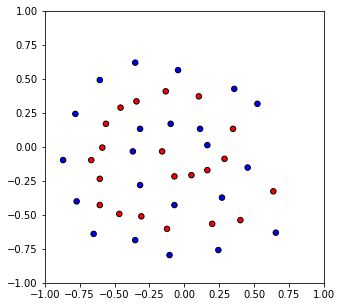

In [4]:
plt.figure(figsize=(5,5))
plt.axis([-1,1,-1,1])
plt.scatter(*X_train.T, c=np.array(['b','r'])[y_train], ec='k', s=30);

In [5]:
clf = tree.DecisionTreeClassifier(criterion='entropy', max_depth=15)
clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='entropy', max_depth=15,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')

In [6]:
xyr = np.arange(-1, 1, .01)
xx, yy = np.meshgrid(xyr, xyr)

def getc(X,y):
    clf = tree.DecisionTreeClassifier(criterion='entropy')
    clf.fit(X,y)
    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    plot = plt.contourf(xx, yy, Z, cmap=my_coolwarm)
    return clf, Z, plot

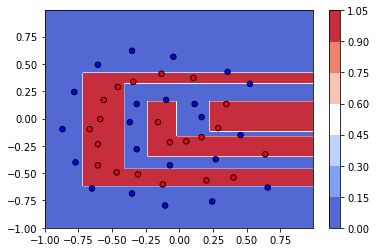

In [7]:
clf, _, plot = getc(X_train,y_train)
plt.scatter(*X_train.T, c=np.array(['b','r'])[y_train], ec='k', s=30, alpha=1)
plt.colorbar(plot)

  8%|▊         | 7/84 [00:00<00:01, 64.77it/s]Plotting the average of the first 15 bootstraps...
Getting the rest of the 100 iterations...
100%|██████████| 84/84 [00:01<00:00, 68.88it/s]
Plotting the average of the 100 iterations...


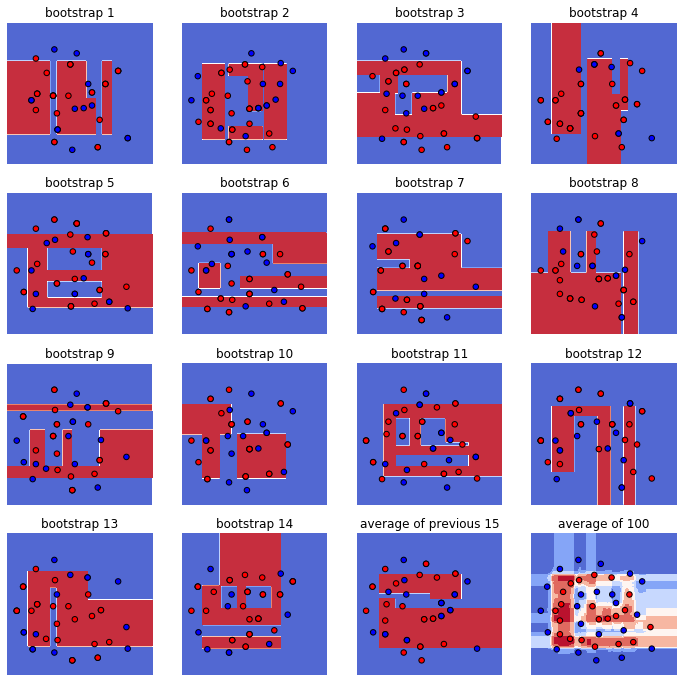

In [8]:
plt.figure(figsize=(12,12))

N_iters = 100 #running higher than 1000 crashes on my machine; 100 was sufficient to see the effect

def bootstrap_and_plot(all_Z, plot=True):
    samples = random.choices(list(zip(X_train, y_train)), k=43) #with replacement
    X_samples = [tup[0] for tup in samples]
    y_samples = [tup[1] for tup in samples]
    clf, Z, plot = getc(X_samples, y_samples)
    all_Z += Z
    if plot:
        plt.scatter(*np.array(X_samples).T, c=np.array(['b','r'])[y_train], ec='k', s=30, alpha=1)
    return all_Z

print('Plotting the first 15 bootstraps...')
all_Z = np.zeros(xx.shape)
for i in tqdm(range(1,15)):
    plt.subplot(4,4,i)
    plt.title('bootstrap {}'.format(i))
    plt.axis([-1,1,-1,1])
    plt.axis('off')
    all_Z = bootstrap_and_plot(all_Z, plot=True)

print('Plotting the average of the first 15 bootstraps...')
# it 15 = average of previous 15
avg_at_15 = all_Z / 15
plt.subplot(4,4,15)
plt.title('average of previous 15')
plt.axis([-1,1,-1,1])
plt.axis('off')
plt.contourf(xx, yy, avg_at_15, cmap=my_coolwarm, vmin=0, vmax=1)
plt.scatter(*X_train.T, c=np.array(['b','r'])[y_train], ec='k', s=30);

print('Getting the rest of the {} iterations...'.format(N_iters))
for i in tqdm(range(16, N_iters)):
    all_Z = bootstrap_and_plot(all_Z, plot=False)

print('Plotting the average of the {} iterations...'.format(N_iters))
# it 16 = average of all iters
final_Z = all_Z / N_iters
plt.subplot(4,4,16)
plt.title('average of {}'.format(N_iters))
plt.axis([-1,1,-1,1])
plt.axis('off')
plt.contourf(xx, yy, final_Z, cmap=my_coolwarm, vmin=0, vmax=1)
plt.scatter(*X_train.T, c=np.array(['b','r'])[y_train], ec='k', s=30);

## 2A)

In [21]:
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier

In [12]:
df = pd.read_csv('UCI_Credit_Card.csv', index_col='ID')
df

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
ID,,,,,,,,,,,,,,,,,,,,,
1,20000.0,2,2,1,24,2,2,-1,-1,-2,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
2,120000.0,2,2,2,26,-1,2,0,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
3,90000.0,2,2,2,34,0,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
4,50000.0,2,2,1,37,0,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
5,50000.0,1,2,1,57,-1,0,-1,0,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29996,220000.0,1,3,1,39,0,0,0,0,0,...,88004.0,31237.0,15980.0,8500.0,20000.0,5003.0,3047.0,5000.0,1000.0,0
29997,150000.0,1,3,2,43,-1,-1,-1,-1,0,...,8979.0,5190.0,0.0,1837.0,3526.0,8998.0,129.0,0.0,0.0,0
29998,30000.0,1,2,2,37,4,3,2,-1,0,...,20878.0,20582.0,19357.0,0.0,0.0,22000.0,4200.0,2000.0,3100.0,1


In [13]:
y = list(df['default.payment.next.month'])

In [16]:
X = df.drop(labels=['default.payment.next.month'], axis=1)

In [18]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

In [44]:
n_estimators=100
max_features=10
clf = RandomForestClassifier(criterion='entropy', n_estimators=n_estimators, max_features=max_features)
scores = cross_val_score(clf, X, y, cv=5)
print('RandomForest with {} estimators and {} max features gives an average acc of {}'.format(n_estimators, max_features, np.mean(scores)))

RandomForest with 100 estimators and 10 max features gives an average acc of 0.8155339756889066


In [25]:
clf.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='entropy',
                       max_depth=None, max_features=10, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [31]:
# ii) 5 top predictors of default
importances = clf.feature_importances_
indices = np.argsort(importances)[::-1]
df.columns[indices][:5]

Index(['PAY_0', 'AGE', 'BILL_AMT1', 'LIMIT_BAL', 'PAY_AMT2'], dtype='object')

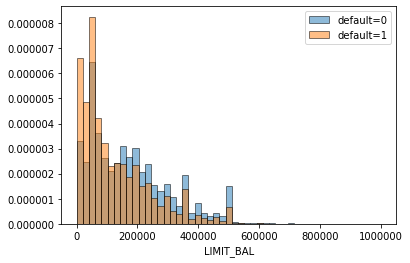

In [38]:
# iii) LIMIT_BAL plots

default0 = df[df['default.payment.next.month'] == 0]['LIMIT_BAL']
default1 = df[df['default.payment.next.month'] == 1]['LIMIT_BAL']

plt.hist(default0, density=True, alpha=0.5, bins=np.linspace(0,1000000,50), ec='k', label='default=0')
plt.hist(default1, density=True, alpha=0.5, bins=np.linspace(0,1000000,50), ec='k', label='default=1')
plt.xlabel('LIMIT_BAL')
plt.legend()

## 2B)

In [39]:
from sklearn.linear_model import LogisticRegression

logreg = LogisticRegression()
scores = cross_val_score(clf, X, y, cv=5)

In [43]:
print('LogisticRegression gives an average acc of {}'.format(np.mean(scores)))

LogisticRegression gives an average acc of 0.8163005479194597


The LogisticRegression and RandomForest classifiers give virtually the same average accuracies after training on 5-fold cross-validation.